In [1]:
import os, sys
sys.path.append(os.chdir(os.getcwd()+"/.."))

import numpy as np
import matplotlib
from matplotlib import pyplot as plt
%matplotlib inline


from src.potential1D import harmonicOsc1D, envelopedPotential
from src.integrator import monteCarloIntegrator, metropolisMonteCarloIntegrator, positionVerletIntegrator
from src.system import system

from visualisation.plotSimulations import static_sim_plots
from visualisation.animationSimulation import animation_trajectory, animation_EDS_trajectory


# Plots of Simulations

## Stochastic Integrators

last_state:  State(position=-4.305678699919584, temperature=298.0, totEnergy=9.2694345334706, totPotEnergy=9.2694345334706, totKinEnergy=0, dhdpos=-7.2700000000000005, velocity=None)
Trajectory length:  250


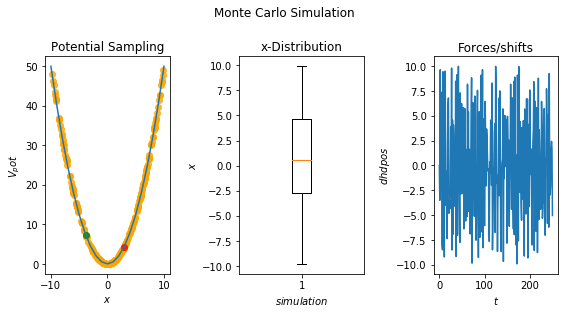

In [3]:
#Simple Monte Carlo simulation:
#settings
sim_steps = 250
x_min, x_max = (-10, 10)
max_step_size = 2.0
pot=harmonicOsc1D()
integrator = monteCarloIntegrator(spaceRange=[x_min, x_max])#maxStepSize=max_step_size,
sys=system(potential=pot, integrator=integrator)

#simulate
cur_state = sys.simulate(sim_steps, withdrawTraj=True)
print("last_state: ", cur_state)
print("Trajectory length: ",len(sys.trajectory))

#plot
static_sim_plots(sys, title="Monte Carlo Simulation", x_range=range(-10,11))

last_state:  State(position=1.1800000000000033, temperature=298.0, totEnergy=0.6962000000000038, totPotEnergy=0.6962000000000038, totKinEnergy=0, dhdpos=3.74, velocity=None)
250


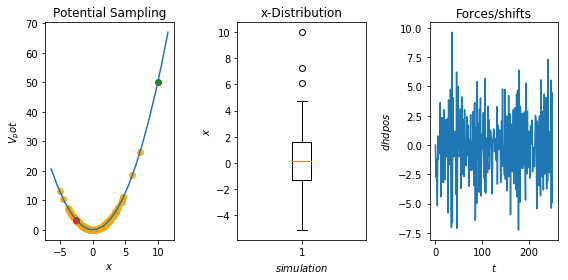

In [39]:
#Simple metropolis Monte Carlo simulation
#settings
sim_steps=250
#criterion= lambda ene_new, currentState: (ene_new < currentState.totPotEnergy)
x_min, x_max = (-10, 10)

pot=harmonicOsc1D()
integrator = metropolisMonteCarloIntegrator(spaceRange=[x_min, x_max])# metropolisCriterion=criterion (spaceRange=[min(x2), max(x2)], maxStepSize=max_step_size,
sys=system(potential=pot, integrator=integrator,  position=10)

#simulate
cur_state = sys.simulate(steps=sim_steps, withdrawTraj=True)
print("last_state: ", cur_state)
print(len(sys.trajectory))

#plot
static_sim_plots(sys, )

## Newtonian Integrator

0
Progress: 	0%	10%	20%	30%	40%	50%	60%	70%	80%	90%	100%
init_state State(position=-10, temperature=298.0, totEnergy=50.0, totPotEnergy=50.0, totKinEnergy=0.0, dhdpos=0, velocity=0) 

last_state:  State(position=-2.936389646346983, temperature=298.0, totEnergy=51.42519299570866, totPotEnergy=4.31119207758688, totKinEnergy=47.11400091812178, dhdpos=-1.9656785573187205, velocity=-9.707110890282626) 

Trajectory length:  2500


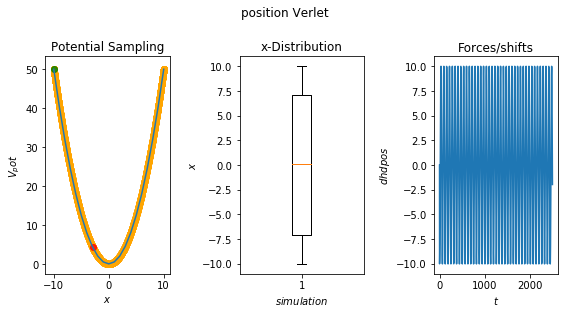

In [3]:
#Simple Verlet integration simulation:
#UNDER DEVELOPMENT!
# The temperature is not constant!!!
#settings
sim_steps = 2500
x_min, x_max = (-10, 10)
max_step_size = 2.0
pot=harmonicOsc1D()
integrator = positionVerletIntegrator(dt=0.1)#maxStepSize=max_step_size,
sys=system(potential=pot, integrator=integrator, position=-10)
#simulate
sys._currentVelocities = 0
sys._currentPosition = -10
print(sys._currentVelocities)
cur_state = sys.simulate(sim_steps, withdrawTraj=True, initSystem=False)
print("init_state", sys.trajectory[0], "\n")
print("last_state: ",  sys.trajectory[-1], "\n")
print("Trajectory length: ",len(sys.trajectory))
#plot
static_sim_plots(sys, title="position Verlet", x_range=range(-10,11))

# Animations of Simulations

## Stochastic Integrators

## super  Monte Carlo Simulation:

200
<src.system.system object at 0x7fb40fd3a160> [-10, 10]


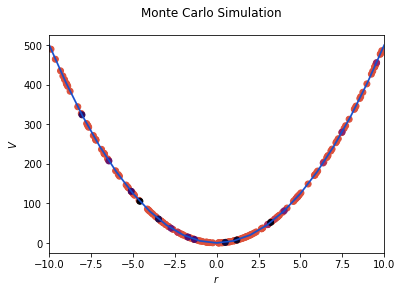

In [2]:
#settings
sim_steps = 200
space_range = [-10, 10]
pot=harmonicOsc1D(fc=10)
integrator = monteCarloIntegrator(spaceRange=space_range) #, maxStepSize=max_step_size,
sys=system(potential=pot, integrator=integrator,  position=10)

#simulate
cur_state = sys.simulate(sim_steps, withdrawTraj=True)
print(len(sys.trajectory))

#plot
print(sys, space_range)
ani, out_path = animation_trajectory(sys, x_range=space_range, title="Monte Carlo Simulation")

import tempfile
os.chdir(tempfile.gettempdir())
from IPython.display import HTML
HTML(ani.to_jshtml())

last_state:  State(position=-2.416792189075826, temperature=298.0, totEnergy=5.840884485177924, totPotEnergy=5.840884485177924, totKinEnergy=0, dhdpos=-0.6259294646927733, velocity=None)
250


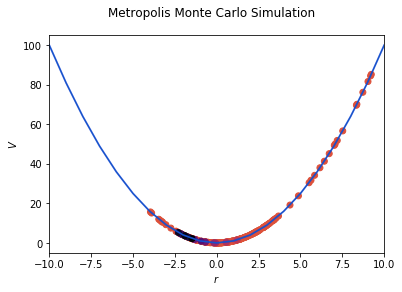

In [5]:
#super easy Metropolis_MonteCarlo simulation
#settings
space_range = [-10, 10]
sim_steps=250
pot=harmonicOsc1D(fc=2)
integrator = metropolisMonteCarloIntegrator(randomnessIncreaseFactor=5) 
sys=system(potential=pot, integrator=integrator,  position=10)

#simulate
cur_state = sys.simulate(sim_steps, withdrawTraj=True) #500000, withdrawTraj=True)
print("last_state: ", cur_state)
print(len(sys.trajectory))


#plot
ani, out_path = animation_trajectory(sys, x_range=space_range, title="Metropolis Monte Carlo Simulation")

##put it into jupyter:
import tempfile
os.chdir(tempfile.gettempdir())
from IPython.display import HTML
HTML(ani.to_jshtml())


last_state:  State(position=-10.855083195756126, temperature=298.0, totEnergy=-0.2688327283354899, totPotEnergy=-0.2688327283354899, totKinEnergy=0, dhdpos=-0.9098833037297694, velocity=None)
32000


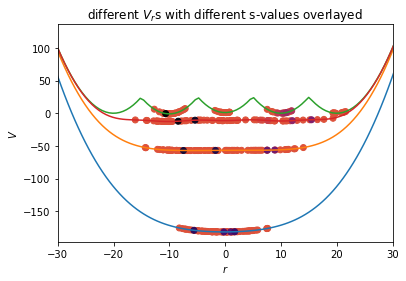

In [4]:
#Metropolis Monte Carlo Simulation for EDS
##Construct potential
fc=2
Eoffs=(0, 0, 0, 1, -1)
positions = [x / float(10) for x in range(-300, 301)]
V_is=[harmonicOsc1D(x_shift=-20, fc=fc), harmonicOsc1D(x_shift=20, fc=fc),
      harmonicOsc1D(x_shift=10, fc=fc), harmonicOsc1D(x_shift=-10, fc=fc), harmonicOsc1D(x_shift=0, fc=fc)]
eds_pot = envelopedPotential(V_is=V_is, s=1.0, Eoff_i=Eoffs)

#Build System
integrator = metropolisMonteCarloIntegrator() 
sys=system(potential=eds_pot, integrator=integrator) #,  position=20)
del sys.trajectory[:]


#simulate
svals = [1.0, 0.02, 0.01,  0.005,  0.005,  0.01, 0.02, 1.0]
for s in svals*20:
    sys.potential.s = s
    cur_state = sys.simulate(200, withdrawTraj=False)
print("last_state: ", cur_state)
print(len(sys.trajectory))


#animation
ani, out_path = animation_EDS_trajectory(sys, [min(positions),max(positions)], s_values=list(set(svals)), step_size=100)

import tempfile
os.chdir(tempfile.gettempdir())
from IPython.display import HTML
HTML(ani.to_jshtml())


In [ ]:
#Simple Verlet integration simulation:
#UNDER DEVELOPMENT!The temperature is not constant!!! -- BUGGY!
#settings
sim_steps = 200
x_min, x_max = (-10, 10)
max_step_size = 2.0
pot=harmonicOsc1D()
integrator = positionVerletIntegrator(dt=0.1)#maxStepSize=max_step_size,
sys=system(potential=pot, integrator=integrator, position=-7.5)
sys._currentVelocities = 0

#simulate
cur_state = sys.simulate(sim_steps, withdrawTraj=True, initSystem=False)
print("init_state", sys.trajectory[0], "\n")
print("last_state: ",  sys.trajectory[-1], "\n")
print("Trajectory length: ",len(sys.trajectory))

#animation
ani, out_path = animation_trajectory(sys, [x_min, x_max])

import tempfile
os.chdir(tempfile.gettempdir())
from IPython.display import HTML
HTML(ani.to_jshtml())

init_state State(position=-7.5, temperature=298.0, totEnergy=28.125, totPotEnergy=28.125, totKinEnergy=0.0, dhdpos=0, velocity=0) 

last_state:  State(position=-3.347435815064061, temperature=298.0, totEnergy=27.02934279831914, totPotEnergy=5.602663267986798, totKinEnergy=21.42667953033234, dhdpos=-4.002060585911183, velocity=6.546247708471219) 

Trajectory length:  200


last_state:  State(position=19.577181585995213, temperature=298.0, totEnergy=0.17877541122152368, totPotEnergy=0.17877541122152368, totKinEnergy=0, dhdpos=-0.2115923513000968, velocity=None)
96000
/tmp


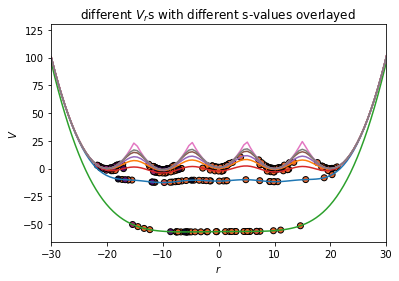

In [4]:
#Metropolis Monte Carlo Simulation for EDS
##Construct potential
fc=2
Eoffs=(0, 0, 0, 1, -1)
positions = [x / float(10) for x in range(-300, 301)]
V_is=[harmonicOsc1D(x_shift=-20, fc=fc), harmonicOsc1D(x_shift=20, fc=fc),
      harmonicOsc1D(x_shift=10, fc=fc), harmonicOsc1D(x_shift=-10, fc=fc), harmonicOsc1D(x_shift=0, fc=fc)]
eds_pot = envelopedPotential(V_is=V_is, s=1.0, Eoff_i=Eoffs)

#Build System
integrator = metropolisMonteCarloIntegrator() 
sys=system(potential=eds_pot, integrator=integrator) #,  position=20)
del sys.trajectory[:]


#simulate
values = [1.0, 0.09, 0.07,  0.05, 0.04, 0.03, 0.02, 0.01]
svals = values+list(reversed(values))
for s in svals*30:
    sys.potential.s = s
    cur_state = sys.simulate(200, withdrawTraj=False)
print("last_state: ", cur_state)
print(len(sys.trajectory))



import tempfile
tmp_dir = tempfile.gettempdir()
os.chdir(tmp_dir)


#animation
ani, out_path = animation_EDS_trajectory(sys, [min(positions),max(positions)], s_values=list(set(svals)), step_size=300)
print(tmp_dir)

from IPython.display import HTML
HTML(ani.to_jshtml())


In [ ]:
#Metropolis Monte Carlo Simulation for EDS
##Construct potential
fc=5
Eoffs=(0, 0)
V_is=[harmonicOsc1D(x_shift=4, fc=fc), harmonicOsc1D(x_shift=-4, fc=fc)]
eds_pot = envelopedPotential(V_is=V_is, s=1.0, Eoff_i=Eoffs)

#Build System
integrator = metropolisMonteCarloIntegrator() 
sys=system(potential=eds_pot, integrator=integrator) #,  position=20)
del sys.trajectory[:]


#simulate
values = [1.0,  0.05, 0.03, 0.0125, 0.01]
svals = values+list(reversed(values))
for s in svals*5:
    sys.potential.s = s
    cur_state = sys.simulate(200, withdrawTraj=False)
print("last_state: ", cur_state)
print(len(sys.trajectory))



import tempfile
tmp_dir = tempfile.gettempdir()
os.chdir(tmp_dir)


#animation
tmp_dir = "/home/bschroed"
out_path=tmp_dir+"/harmOsc.mp4"
matplotlib.rcParams['animation.embed_limit'] = 20971520*3

ani, out_path = animation_EDS_trajectory(sys, x_range=[-10,10], 
                                         s_values=list(set(svals)), step_size=10, 
                                         out_path=out_path, out_writer="ffmpeg", dpi=600, tot_pot_resolution=1000)
print(tmp_dir)

from IPython.display import HTML
HTML(ani.to_jshtml())



In [ ]:
#Metropolis Monte Carlo Simulation for EDS
##Construct potential
fc=5
Eoffs=(0, 0)
V_is=[harmonicOsc1D(x_shift=4, fc=fc), harmonicOsc1D(x_shift=-4, fc=fc)]
eds_pot = envelopedPotential(V_is=V_is, s=1.0, Eoff_i=Eoffs)

#Build System
integrator = metropolisMonteCarloIntegrator() 
sys=system(potential=eds_pot, integrator=integrator) #,  position=20)
del sys.trajectory[:]


#simulate
values = [1.0,  0.05, 0.03, 0.0125, 0.01]
svals = values+list(reversed(values))
for s in svals*5:
    sys.potential.s = s
    cur_state = sys.simulate(200, withdrawTraj=False)
print("last_state: ", cur_state)
print(len(sys.trajectory))



import tempfile
tmp_dir = tempfile.gettempdir()
os.chdir(tmp_dir)


#animation
tmp_dir = "/home/bschroed"
out_path=tmp_dir+"/harmOsc.mp4"
matplotlib.rcParams['animation.embed_limit'] = 20971520*3

ani, out_path = animation_EDS_trajectory(sys, x_range=[-10,10], 
                                         s_values=list(set(svals)), step_size=10, 
                                         out_path=out_path, out_writer="ffmpeg", dpi=600, tot_pot_resolution=1000)
print(tmp_dir)

from IPython.display import HTML
HTML(ani.to_jshtml())

In [2]:
#Newton Simulation for EDS
##Construct potential
fc=20
Eoffs=(0, 0)
V_is=[harmonicOsc1D(x_shift=7, fc=fc), harmonicOsc1D(x_shift=-7, fc=fc)]
eds_pot = envelopedPotential(V_is=V_is, s=1.0, Eoff_i=Eoffs)

#Build System
integrator = positionVerletIntegrator(dt=1)#maxStepSize=max_step_size,
sys=system(potential=eds_pot, integrator=integrator) #,  position=20)
del sys.trajectory[:]


#simulate
values = [1.0, 0.001]
svals = values+list(reversed(values))
for s in svals*4:
    sys.potential.s = s
    cur_state = sys.simulate(200, withdrawTraj=False)
print("last_state: ", cur_state)
print(len(sys.trajectory))



import tempfile
tmp_dir = tempfile.gettempdir()
os.chdir(tmp_dir)


#animation
tmp_dir = "/home/bschroed"
out_path=tmp_dir+"/harmOsc.mp4"
out_path = None
matplotlib.rcParams['animation.embed_limit'] = 20971520*3

ani, out_path = animation_EDS_trajectory(sys, x_range=[-10,10], s_values=list(set(svals)), step_size=1)

from IPython.display import HTML
HTML(ani.to_jshtml())



TypeError: object of type 'float' has no len()